<a href="https://colab.research.google.com/github/samuelsushanth/machinelearninganddataanalysisprojects/blob/main/bth_ml_project_group14.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

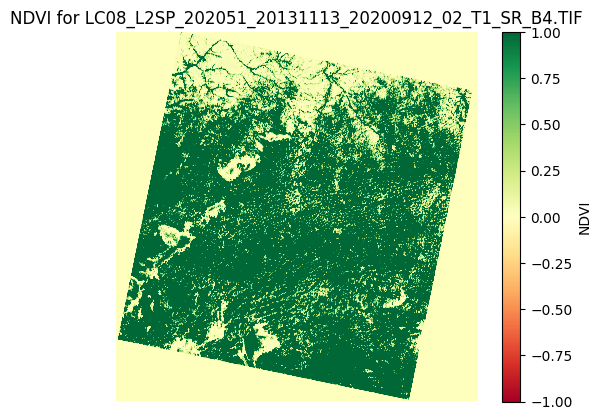

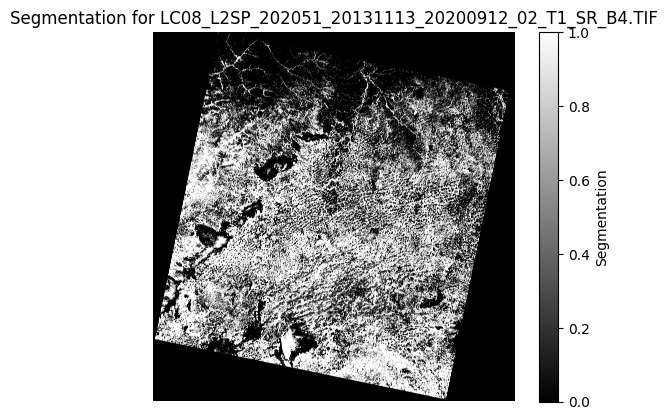

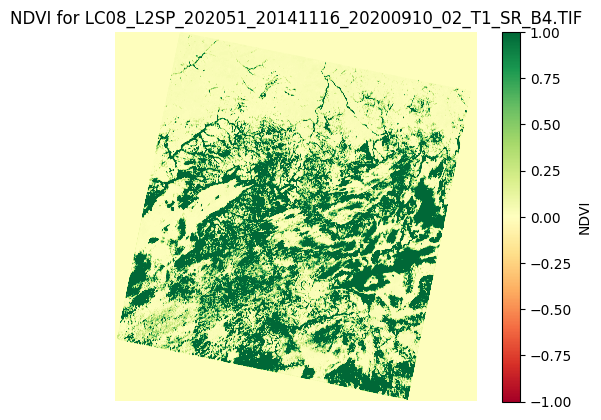

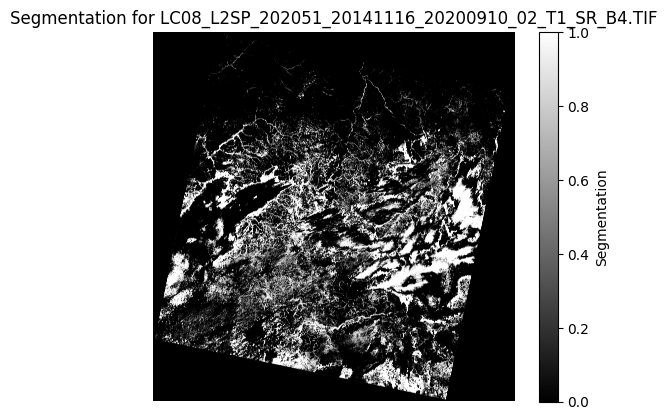

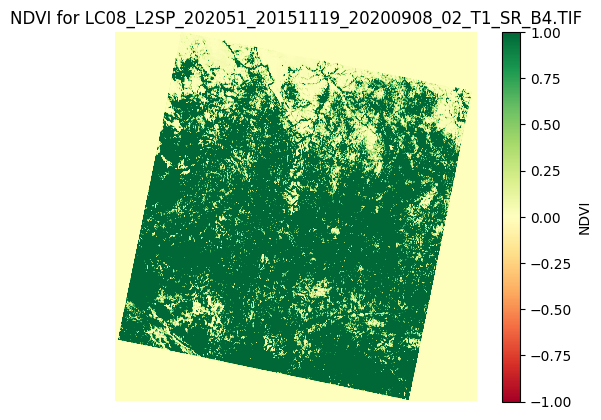

...

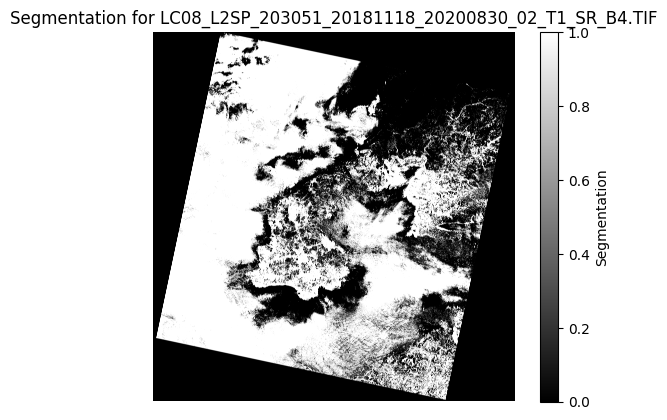

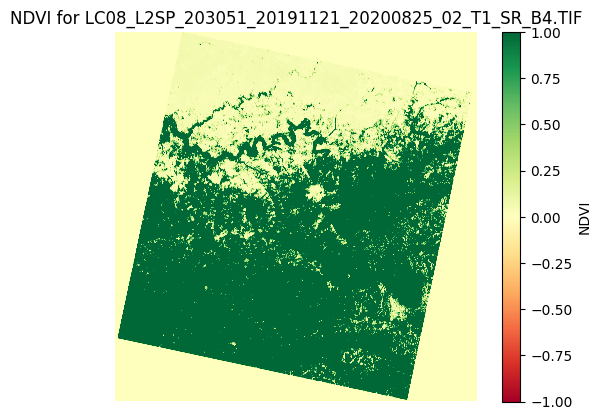

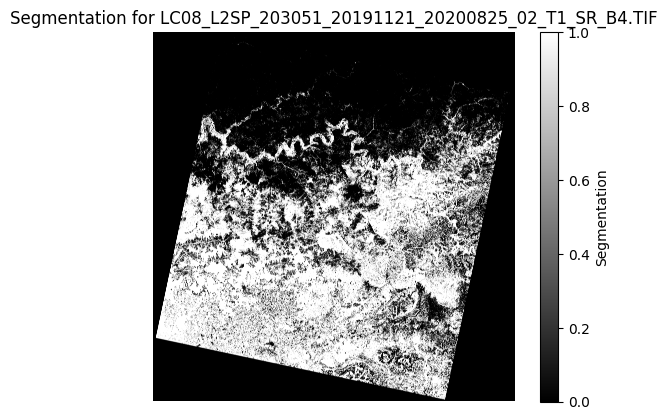

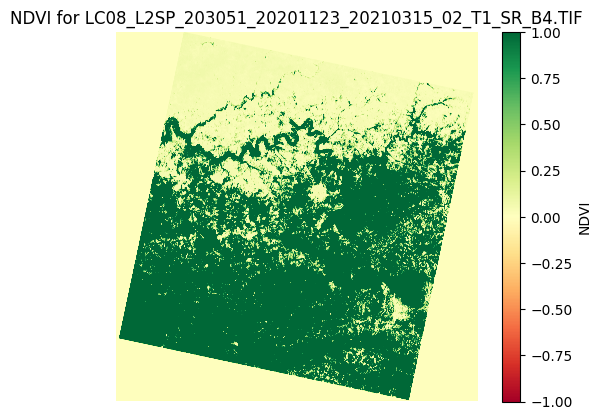

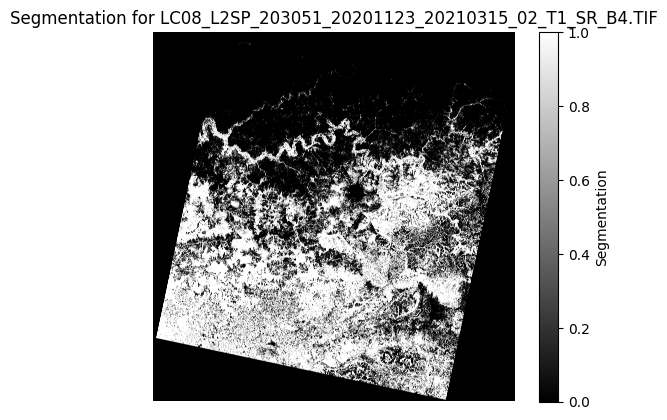

In [ ]:
import os
import rasterio
import numpy as np
import matplotlib.pyplot as plt

def compute_ndvi(nir_path, red_path):
    with rasterio.open(nir_path) as nir_src:
        nir_data = nir_src.read(1)
    with rasterio.open(red_path) as red_src:
        red_data = red_src.read(1)

    # NDVI calculation
    ndvi = (nir_data - red_data) / (nir_data + red_data + 1e-8)
    return ndvi

def threshold_segmentation(ndvi_data, threshold=0.2):
    # Binary segmentation based on NDVI threshold
    # Vegetation areas will be marked as 1 and non-vegetation as 0
    return (ndvi_data > threshold).astype(np.uint8)

# Directory containing your files
dir_path = "."

# Retrieve B3 and B4 files
b3_files = sorted([os.path.join(dir_path, f) for f in os.listdir(dir_path) if 'B3' in f])
b4_files = sorted([os.path.join(dir_path, f) for f in os.listdir(dir_path) if 'B4' in f])

for b3_path, b4_path in zip(b3_files, b4_files):
    ndvi_data = compute_ndvi(b4_path, b3_path)  # B4 is NIR and B3 is Red

    # Display NDVI
    plt.imshow(ndvi_data, cmap='RdYlGn', vmin=-1, vmax=1)
    plt.colorbar(label='NDVI')
    plt.title(f"NDVI for {os.path.basename(b4_path)}")
    plt.axis('off')
    plt.show()

    segmented_data = threshold_segmentation(ndvi_data)

    # Display Segmentation
    plt.imshow(segmented_data, cmap='gray')
    plt.colorbar(label='Segmentation')
    plt.title(f"Segmentation for {os.path.basename(b4_path)}")
    plt.axis('off')
    plt.show()


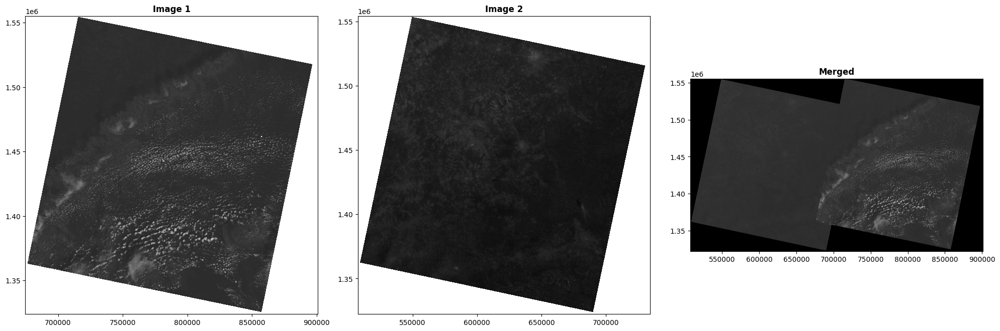

In [ ]:
import rasterio
from rasterio.merge import merge
from rasterio.plot import show
import os
import matplotlib.pyplot as plt

# Define paths
dir_path = "."
b3_files = sorted([os.path.join(dir_path, f) for f in os.listdir(dir_path) if 'B3' in f])

# Get the B3 files for 2013 (or any other year you want to test)
b3_files_year = [file for file in b3_files if "2013" in file]

# Open the two raster images
src1 = rasterio.open(b3_files_year[0])
src2 = rasterio.open(b3_files_year[1])

# Merge them directly using the rasterio.merge.merge() function
merged_data, merged_transform = merge([src1, src2])

# Display the result
fig, axs = plt.subplots(1, 3, figsize=(20, 20))

show(src1, ax=axs[0], cmap='gray', title="Image 1")
show(src2, ax=axs[1], cmap='gray', title="Image 2")
show(merged_data, ax=axs[2], transform=merged_transform, cmap='gray', title="Merged")

plt.tight_layout()
plt.show()


In [ ]:
import os
import rasterio
from rasterio import mask
from rasterio.merge import merge
from rasterio.plot import show
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from shapely.geometry import box
from rasterio.warp import transform_bounds
from rasterio.io import MemoryFile
from IPython.display import HTML

# Setting the backend for Matplotlib
import matplotlib
matplotlib.use('TkAgg')

# Define paths
dir_path = "."
all_files = sorted(os.listdir(dir_path))

# Create a list to store the merged and cropped data for each band and year
merged_cropped_data_b3 = []
merged_cropped_data_b4 = []

# Define Niokolo-Koba forest extent in WGS84
west, south, east, north = -13.6, 12.8, -12.8, 13.6
niokolokoba_extent_wgs84 = box(west, south, east, north)

# Process both B3 and B4
for band in ['B3', 'B4']:
    band_files = [f for f in all_files if band in f and f.endswith(".TIF")]

    band_files_by_year = {}
    for file in band_files:
        year = file.split('_')[3][:4]
        if year not in band_files_by_year:
            band_files_by_year[year] = []
        band_files_by_year[year].append(file)

    for year, files in band_files_by_year.items():
        if len(files) != 2:
            print(f"Skipped {year} due to insufficient {band} images.")
            continue

        with rasterio.open(os.path.join(dir_path, files[0])) as src1, \
             rasterio.open(os.path.join(dir_path, files[1])) as src2:

            # Reproject Niokolo-Koba extent to match raster CRS
            projected_bounds = transform_bounds('EPSG:4326', src1.crs, west, south, east, north)
            niokolokoba_extent = box(*projected_bounds)

            merged_data, merged_transform = merge([src1, src2])

            # Create a temporary raster from the merged data
            with MemoryFile() as memfile:
                with memfile.open(driver='GTiff', height=merged_data.shape[1], width=merged_data.shape[2], count=1, dtype=str(merged_data.dtype), crs=src1.crs, transform=merged_transform) as dataset:
                    dataset.write(merged_data)

                    # Crop the merged data to the Niokolo-Koba extent
                    out_image, out_transform = rasterio.mask.mask(dataset, [niokolokoba_extent], crop=True)

                    # Add the cropped data to the list based on the band
                    if band == 'B3':
                        merged_cropped_data_b3.append(out_image)
                    else:
                        merged_cropped_data_b4.append(out_image)

# Compute NDVI for each year
ndvi_list = []
for b3, b4 in zip(merged_cropped_data_b3, merged_cropped_data_b4):
    ndvi = (b4 - b3) / (b4 + b3 + 1e-8)
    ndvi_list.append(ndvi)

# Create animation for NDVI
fig, ax = plt.subplots()
im = ax.imshow(ndvi_list[0][0], cmap='RdYlGn', vmin=-1, vmax=1)
ax.set_title("NDVI - Year: 0")
plt.colorbar(im, ax=ax)

def update_fig(year):
    im.set_array(ndvi_list[year][0])
    ax.set_title(f"NDVI - Year: {year}")

ani = animation.FuncAnimation(fig, update_fig, frames=len(ndvi_list), interval=1000, repeat=True)
HTML(ani.to_jshtml())


In [ ]:
import os
import rasterio
from rasterio.features import shapes
import geopandas as gpd
from shapely.geometry import shape
import shutil

# Paths from previous code block
dir_path = "."
mosaics_folder = os.path.join(dir_path, "mosaics")
shapefiles_folder = os.path.join(dir_path, "shapefiles")

# Make directories for mosaics and shapefiles if they don't exist
os.makedirs(mosaics_folder, exist_ok=True)
os.makedirs(shapefiles_folder, exist_ok=True)

# Filter out any non-TIF files
tif_files = [f for f in all_files if f.endswith(".TIF")]

# Obtain the CRS from the source data
with rasterio.open(os.path.join(dir_path, tif_files[0])) as src:
    source_crs = src.crs

forest_threshold = 0.3  # Define a threshold for forest detection

# Generate shapefiles and save mosaics for each year
for idx, (b3_data, b4_data) in enumerate(zip(merged_cropped_data_b3, merged_cropped_data_b4)):
    year = 2013 + idx  # Assuming starting year is 2013

    # Save the mosaics
    mosaic_path_b3 = os.path.join(mosaics_folder, f"B3_mosaic_{year}.tif")
    mosaic_path_b4 = os.path.join(mosaics_folder, f"B4_mosaic_{year}.tif")

    with rasterio.open(mosaic_path_b3, 'w', driver='GTiff', height=b3_data.shape[1], width=b3_data.shape[2], count=1, dtype=str(b3_data.dtype), crs=source_crs, transform=merged_transform) as dst:
        dst.write(b3_data)

    with rasterio.open(mosaic_path_b4, 'w', driver='GTiff', height=b4_data.shape[1], width=b4_data.shape[2], count=1, dtype=str(b4_data.dtype), crs=source_crs, transform=merged_transform) as dst:
        dst.write(b4_data)

    # Calculate NDVI
    ndvi_data = (b4_data - b3_data) / (b4_data + b3_data + 1e-8)

    # Convert NDVI to a binary forest/non-forest mask
    forest_mask = (ndvi_data[0] > forest_threshold).astype(rasterio.uint8)

    # Vectorize the forest mask
    results = list(
        ({'properties': {'raster_val': v}, 'geometry': s}
         for i, (s, v) in enumerate(
             shapes(forest_mask, transform=merged_transform))))

    # Save to shapefile
    year_folder = os.path.join(shapefiles_folder, f"forest_{year}")
    os.makedirs(year_folder, exist_ok=True)
    shapefile_path = os.path.join(year_folder, f"forest_{year}.shp")
    gdf = gpd.GeoDataFrame.from_features(results, crs=source_crs)
    gdf.to_file(shapefile_path)

    # Zip the shapefile components
    shutil.make_archive(os.path.join(shapefiles_folder, f"forest_{year}"), 'zip', year_folder)

    # Remove the temporary year directory to keep only the ZIP
    shutil.rmtree(year_folder)


In [ ]:
import os
import numpy as np
import rasterio
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import tensorflow as tf
from imgaug import augmenters as iaa

# Define the mosaic directory
mosaic_dir = "./mosaics"
b3_files = sorted([os.path.join(mosaic_dir, f) for f in os.listdir(mosaic_dir) if 'B3' in f])
b4_files = sorted([os.path.join(mosaic_dir, f) for f in os.listdir(mosaic_dir) if 'B4' in f])

# Use the first 6 years for training and the last 2 for evaluation
train_b3_files = b3_files[:-2]
train_b4_files = b4_files[:-2]
eval_b3_files = b3_files[-2:]
eval_b4_files = b4_files[-2:]

# Function to extract patches based on NDVI values
def extract_patches(image, patch_size=50, stride=25, threshold=0.5):
    forest_patches = []
    non_forest_patches = []
    for i in range(0, image.shape[0] - patch_size, stride):
        for j in range(0, image.shape[1] - patch_size, stride):
            patch = image[i:i+patch_size, j:j+patch_size]
            mean_ndvi = np.mean(patch)
            if mean_ndvi > threshold:
                forest_patches.append(patch)
            elif mean_ndvi < 0.2:
                non_forest_patches.append(patch)
    return forest_patches, non_forest_patches

# Extract patches from mosaic images
def get_data_from_files(b3_files, b4_files):
    all_forest_patches = []
    all_non_forest_patches = []
    for b3_path, b4_path in zip(b3_files, b4_files):
        with rasterio.open(b4_path) as nir_src:
            nir_data = nir_src.read(1)
        with rasterio.open(b3_path) as red_src:
            red_data = red_src.read(1)
        ndvi_data = (nir_data - red_data) / (nir_data + red_data + 1e-8)

        forest_patches, non_forest_patches = extract_patches(ndvi_data)
        all_forest_patches.extend(forest_patches)
        all_non_forest_patches.extend(non_forest_patches)
    return all_forest_patches, all_non_forest_patches

train_forest, train_non_forest = get_data_from_files(train_b3_files, train_b4_files)
eval_forest, eval_non_forest = get_data_from_files(eval_b3_files, eval_b4_files)

# Data Augmentation
seq = iaa.Sequential([
    iaa.Fliplr(0.5),
    iaa.Flipud(0.5),
    iaa.Rot90((1, 3))
])

train_forest_augmented = seq(images=train_forest)
train_non_forest_augmented = seq(images=train_non_forest)

X_train = train_forest_augmented + train_non_forest_augmented
y_train = [1]*len(train_forest_augmented) + [0]*len(train_non_forest_augmented)

X_eval = eval_forest + eval_non_forest
y_eval = [1]*len(eval_forest) + [0]*len(eval_non_forest)

# Model
model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(50, 50, 1)),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Conv2D(64, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(np.array(X_train), np.array(y_train), epochs=10, batch_size=32, validation_data=(np.array(X_eval), np.array(y_eval)))

# Evaluation
y_pred = model.predict(np.array(X_eval))
y_pred_class = [1 if p > 0.5 else 0 for p in y_pred]

accuracy = accuracy_score(y_eval, y_pred_class)
precision = precision_score(y_eval, y_pred_class)
recall = recall_score(y_eval, y_pred_class)
f1 = f1_score(y_eval, y_pred_class)

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

# Save the model
model.save("./forest_model.h5")


In [ ]:
import os
import tensorflow as tf
import rasterio
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Load the trained model
model_path = "./forest_model.h5"
model = tf.keras.models.load_model(model_path)

# Directory containing mosaics
mosaic_dir = "./sisdona"
predicted_dir = "./predicted"

# Create the 'predicted' directory if it doesn't exist
if not os.path.exists(predicted_dir):
    os.mkdir(predicted_dir)

b3_files = sorted([os.path.join(mosaic_dir, f) for f in os.listdir(mosaic_dir) if 'B3' in f])
b4_files = sorted([os.path.join(mosaic_dir, f) for f in os.listdir(mosaic_dir) if 'B4' in f])

patch_size = 50

def reconstruct_image(patches, original_shape):
    reconstructed = np.zeros(original_shape)
    idx = 0
    for i in range(0, original_shape[0] - patch_size, patch_size):
        for j in range(0, original_shape[1] - patch_size, patch_size):
            reconstructed[i:i+patch_size, j:j+patch_size] = patches[idx]
            idx += 1
    return reconstructed

predicted_images = []
accuracies = []
precisions = []
recalls = []
f1_scores = []

# Loop through B3 and B4 files, compute NDVI, and predict forest cover
for b3_path, b4_path in zip(b3_files, b4_files):
    with rasterio.open(b4_path) as nir_src:
        nir_data = nir_src.read(1)
    with rasterio.open(b3_path) as red_src:
        red_data = red_src.read(1)
    ndvi_data = (nir_data - red_data) / (nir_data + red_data + 1e-8)
    truths = (ndvi_data > 0.5).astype(np.int32).ravel()

    predicted_patches = []

    for i in range(0, ndvi_data.shape[0] - patch_size, patch_size):
        for j in range(0, ndvi_data.shape[1] - patch_size, patch_size):
            patch = ndvi_data[i:i+patch_size, j:j+patch_size]
            reshaped_patch = patch.reshape((1, patch_size, patch_size, 1))
            if patch.shape[0] == 50 and patch.shape[1] == 50:
                prediction = model.predict(reshaped_patch)
                predicted_patches.append(prediction[0][0])

    # Reconstruct the image from the predicted patches
    predicted_image = reconstruct_image(predicted_patches, ndvi_data.shape)
    predicted_images.append(predicted_image)

    # Compute evaluation metrics for this year and append to the lists
    predictions = (predicted_image > 0.5).astype(np.int32).ravel()
    accuracies.append(accuracy_score(truths, predictions))
    precisions.append(precision_score(truths, predictions))
    recalls.append(recall_score(truths, predictions))
    f1_scores.append(f1_score(truths, predictions))

# Save the results
np.save(os.path.join(predicted_dir, 'predicted_images.npy'), predicted_images)
np.save(os.path.join(predicted_dir, 'accuracies.npy'), accuracies)
np.save(os.path.join(predicted_dir, 'precisions.npy'), precisions)
np.save(os.path.join(predicted_dir, 'recalls.npy'), recalls)
np.save(os.path.join(predicted_dir, 'f1_scores.npy'), f1_scores)


1/1 [==============================] - 0s 8ms/step


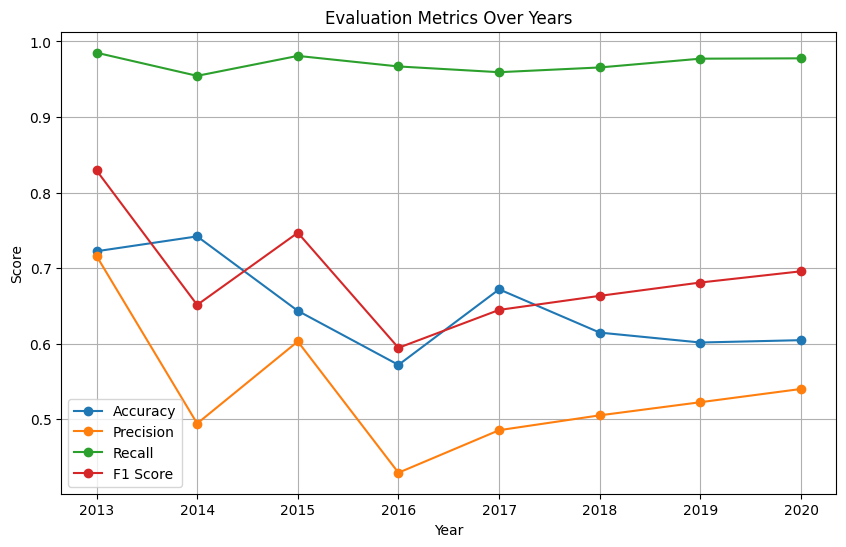

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

# If you're in Jupyter Notebook, use the following line:
%matplotlib inline

# Directory where the predicted images are saved
predicted_dir = "./predicted"

# Load saved results
predicted_image_files = sorted([os.path.join(predicted_dir, f) for f in os.listdir(predicted_dir) if f.endswith('.tif')])
predicted_images = np.load(os.path.join(predicted_dir, 'predicted_images.npy'))
accuracies = np.load(os.path.join(predicted_dir, 'accuracies.npy'))
precisions = np.load(os.path.join(predicted_dir, 'precisions.npy'))
recalls = np.load(os.path.join(predicted_dir, 'recalls.npy'))
f1_scores = np.load(os.path.join(predicted_dir, 'f1_scores.npy'))
years = [os.path.basename(f)[-8:-4] for f in predicted_image_files]

# Plotting the evaluation metrics
plt.figure(figsize=(10, 6))
plt.plot(years, accuracies, '-o', label='Accuracy')
plt.plot(years, precisions, '-o', label='Precision')
plt.plot(years, recalls, '-o', label='Recall')
plt.plot(years, f1_scores, '-o', label='F1 Score')
plt.legend()
plt.title('Evaluation Metrics Over Years')
plt.xlabel('Year')
plt.ylabel('Score')
plt.grid(True)
plt.savefig("./metrics_over_years.png")
plt.show()


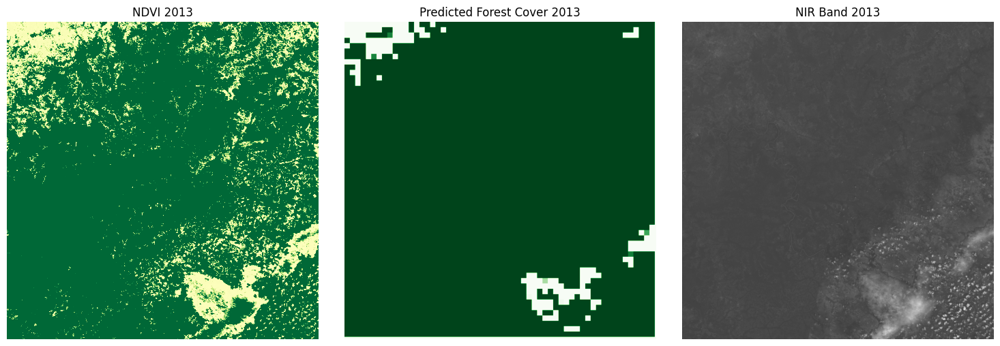

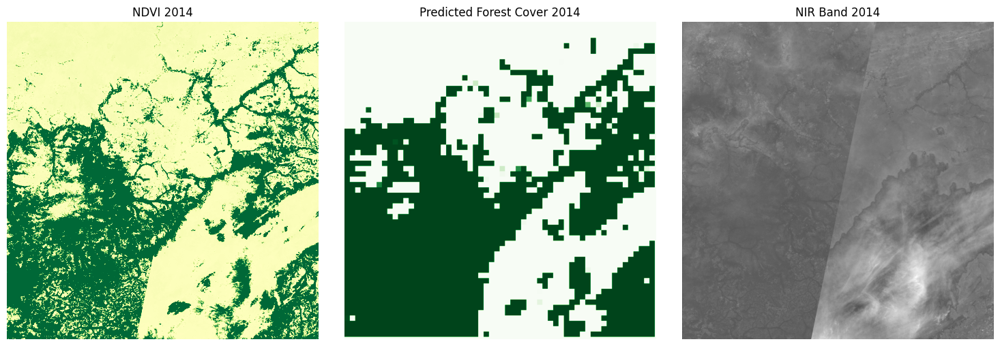

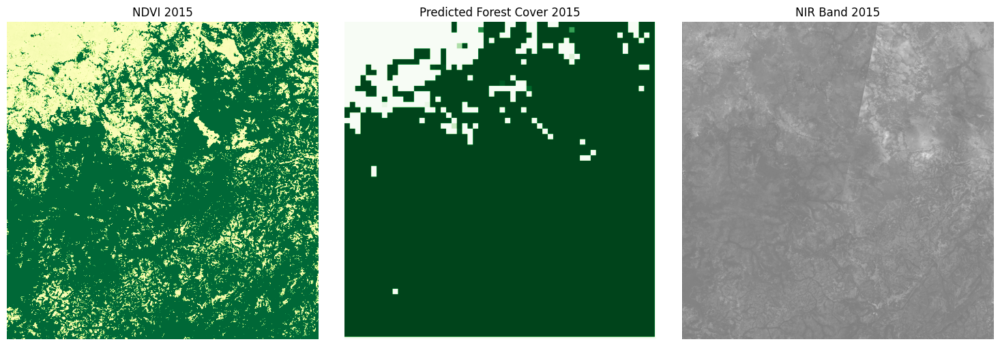

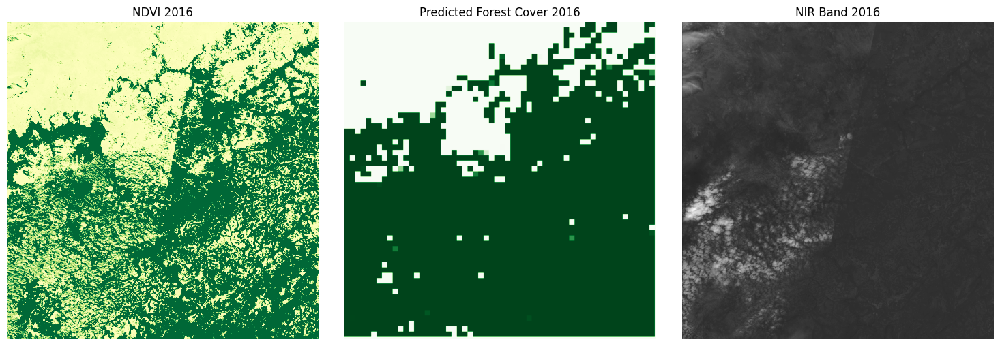

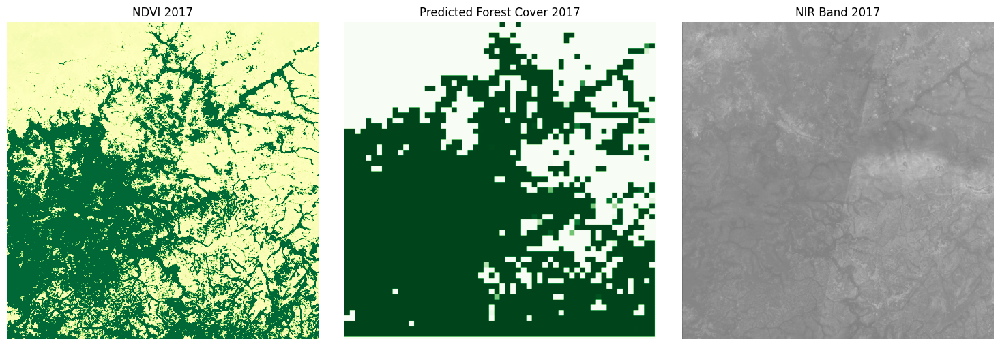

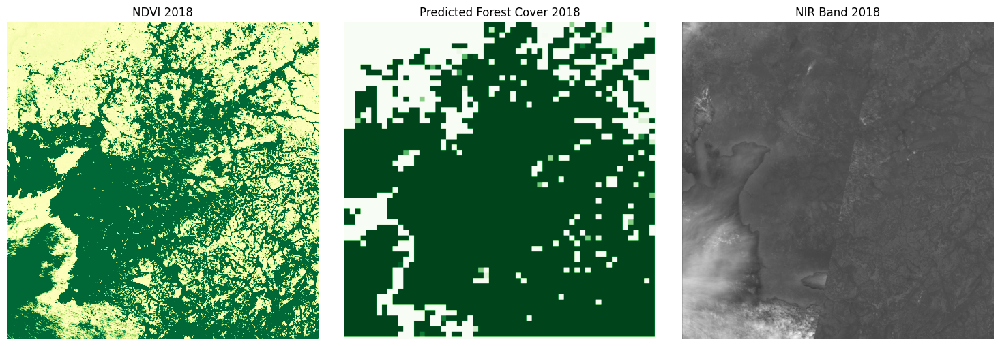

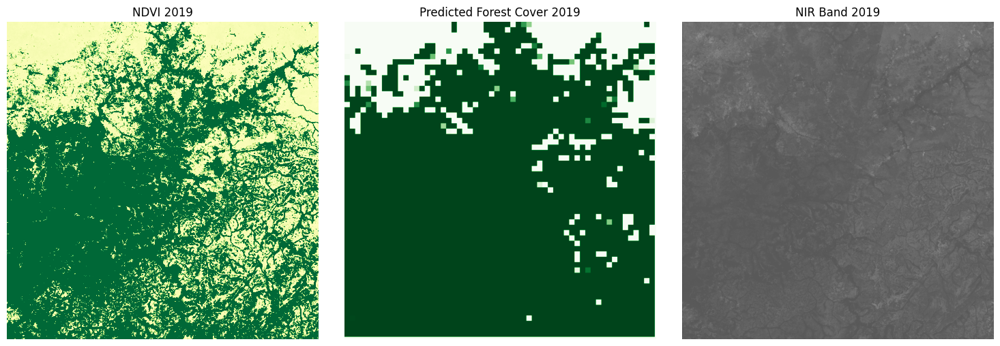

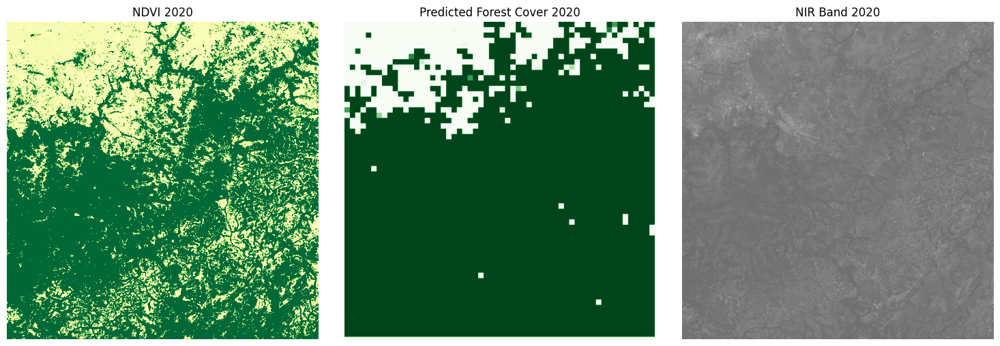

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import rasterio

# Directory paths
predicted_dir = "./predicted"
mosaic_dir = "./mosaics"

# Define b3_files and b4_files
b3_files = sorted([os.path.join(mosaic_dir, f) for f in os.listdir(mosaic_dir) if 'B3' in f])
b4_files = sorted([os.path.join(mosaic_dir, f) for f in os.listdir(mosaic_dir) if 'B4' in f])

# Load saved predicted images
predicted_images = np.load(os.path.join(predicted_dir, 'predicted_images.npy'))

# Function to compute NDVI
def compute_ndvi(nir_band, red_band):
    return (nir_band - red_band) / (nir_band + red_band + 1e-8)

# For each year, visualize the NDVI data alongside the predicted forest cover
for idx, (b3_file, b4_file) in enumerate(zip(b3_files, b4_files)):
    # Load the NIR and RED bands
    with rasterio.open(b4_file) as nir_src:
        nir_band = nir_src.read(1)
    with rasterio.open(b3_file) as red_src:
        red_band = red_src.read(1)

    # Compute NDVI
    ndvi_data = compute_ndvi(nir_band, red_band)

    # Plot
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    axs[0].imshow(ndvi_data, cmap='RdYlGn', vmin=-1, vmax=1)
    axs[0].set_title(f'NDVI {b3_file[-8:-4]}')
    axs[0].axis('off')

    axs[1].imshow(predicted_images[idx], cmap='Greens', vmin=0, vmax=1)
    axs[1].set_title(f'Predicted Forest Cover {b3_file[-8:-4]}')
    axs[1].axis('off')

    axs[2].imshow(nir_band, cmap='gray')
    axs[2].set_title(f'NIR Band {b3_file[-8:-4]}')
    axs[2].axis('off')

    plt.tight_layout()
    plt.show()


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/matplotlib/animation.py:884: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


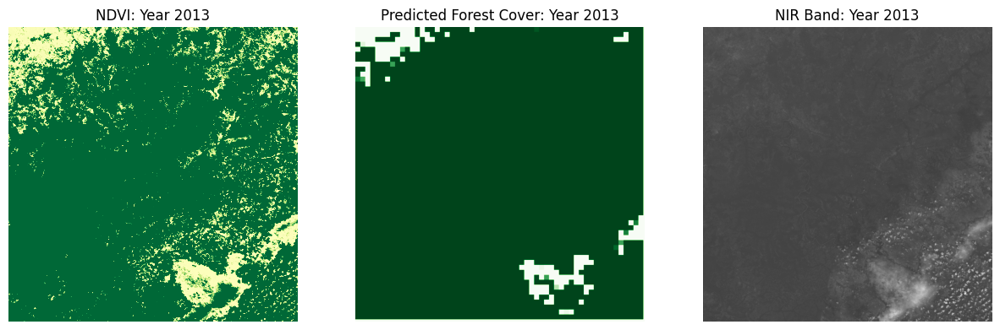

In [ ]:
import os
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Function to compute NDVI
def compute_ndvi(red_band, nir_band):
    return (nir_band - red_band) / (nir_band + red_band + 1e-8)

# Load the data
ndvi_images = []
nir_images = []
predicted_images = []
years = []

for b3_file, b4_file, pred_file in zip(b3_files, b4_files, predicted_image_files):
    year = os.path.basename(b3_file)[-8:-4]

    with rasterio.open(b3_file) as red_src:
        red_band = red_src.read(1)

    with rasterio.open(b4_file) as nir_src:
        nir_band = nir_src.read(1)

    with rasterio.open(pred_file) as pred_src:
        pred_img = pred_src.read(1)

    ndvi_img = compute_ndvi(red_band, nir_band)

    ndvi_images.append(ndvi_img)
    nir_images.append(nir_band)
    predicted_images.append(pred_img)
    years.append(year)

# Animation function
def animate(i):
    ax[0].clear()
    ax[1].clear()
    ax[2].clear()

    ax[0].imshow(ndvi_images[i], cmap='RdYlGn', vmin=-1, vmax=1)
    ax[0].set_title(f"NDVI: Year {years[i]}")

    ax[1].imshow(predicted_images[i], cmap='Greens', vmin=0, vmax=1)
    ax[1].set_title(f"Predicted Forest Cover: Year {years[i]}")

    ax[2].imshow(nir_images[i], cmap='gray')
    ax[2].set_title(f"NIR Band: Year {years[i]}")

    for a in ax:
        a.axis('off')

fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ani = animation.FuncAnimation(fig, animate, frames=len(years), repeat=True)

# Display the animation
HTML(ani.to_jshtml())


In [ ]:
import numpy as np
import os
import rasterio
import matplotlib.pyplot as plt
import folium

# Directory containing the predicted images
predicted_dir = "./predicted"
predicted_image_files = sorted([os.path.join(predicted_dir, f) for f in os.listdir(predicted_dir) if f.endswith('.tif')])

binary_images = []

# Convert model's continuous outputs to binary forest/non-forest classifications
for f in predicted_image_files:
    with rasterio.open(f) as src:
        img = src.read(1)
    binary_img = np.where(img > 0.5, 1, 0)
    binary_images.append(binary_img)

colored_images = []

# Convert binary images to RGBA format with green color for forests and transparent for non-forests
for binary_img in binary_images:
    rgba_image = np.zeros((binary_img.shape[0], binary_img.shape[1], 4), dtype=np.float32)
    rgba_image[binary_img == 1] = [0, 1, 0, 1]  # Forests in Green
    colored_images.append(rgba_image)

# Save the colored images
output_dir = "./colored_images"
if not os.path.exists(output_dir):
    os.mkdir(output_dir)

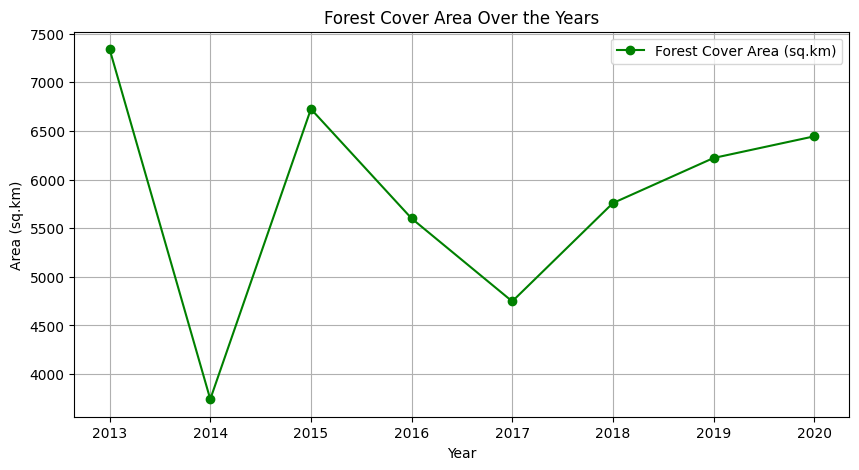

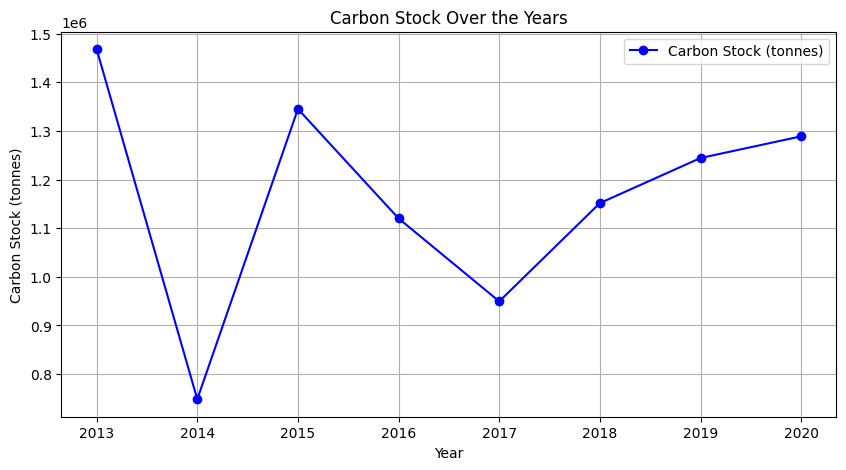

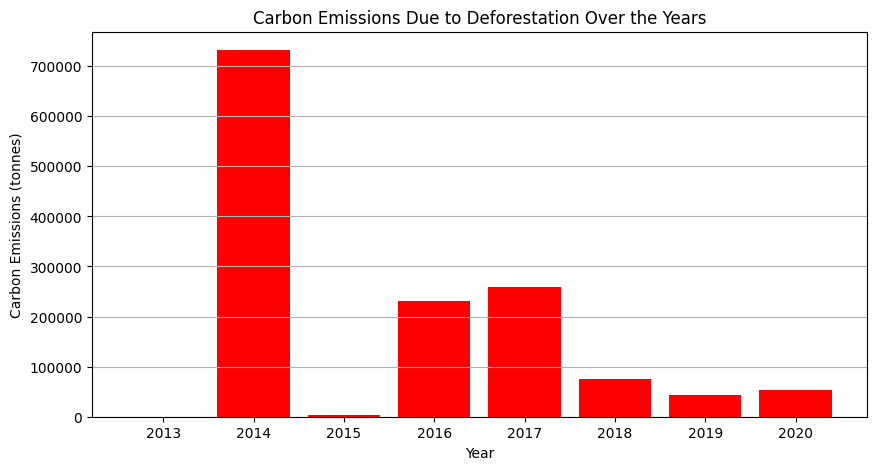

In [ ]:
import numpy as np
import os
import rasterio
from matplotlib import pyplot as plt

# Directory containing the predicted images
predicted_dir = "./predicted"
predicted_image_files = sorted([os.path.join(predicted_dir, f) for f in os.listdir(predicted_dir) if f.endswith('.tif')])

# Constants
PIXEL_AREA = 30 * 30  # Assuming each pixel represents 30m x 30m
AVERAGE_CARBON_DENSITY_MATURE = 200  # Average carbon density for mature forests (tonnes per hectare)
AVERAGE_CARBON_DENSITY_YOUNG = 50  # Average carbon density for young/regrowing forests (tonnes per hectare)

forest_cover_area = []
total_carbon_stock = []
regrowth_areas = []
deforested_areas = []

previous_forest_cover = None
for f in predicted_image_files:
    with rasterio.open(f) as src:
        forest_cover = src.read(1) > 0.5

        # Calculate forest cover area
        forest_area = np.sum(forest_cover) * PIXEL_AREA / (10**6)  # in sq.km
        forest_cover_area.append(forest_area)

        # Calculate carbon stock
        carbon_stock = forest_area * AVERAGE_CARBON_DENSITY_MATURE  # in tonnes
        total_carbon_stock.append(carbon_stock)

        # If there's a previous year's data, calculate regrowth and deforested areas
        if previous_forest_cover is not None:
            regrowth = np.logical_and(~previous_forest_cover, forest_cover)  # Areas that were not forest but are now
            deforestation = np.logical_and(previous_forest_cover, ~forest_cover)  # Areas that were forest but are not now
            regrowth_areas.append(np.sum(regrowth) * PIXEL_AREA / (10**6))
            deforested_areas.append(np.sum(deforestation) * PIXEL_AREA / (10**6))
        else:
            regrowth_areas.append(0)
            deforested_areas.append(0)

        previous_forest_cover = forest_cover

# Carbon emissions due to deforestation (assuming all carbon is released upon deforestation)
carbon_emissions = np.array(deforested_areas) * AVERAGE_CARBON_DENSITY_MATURE

# Visualization
years = list(range(2013, 2021))

# Plotting forest cover area over the years
plt.figure(figsize=(10, 5))
plt.plot(years, forest_cover_area, marker='o', color='green', label="Forest Cover Area (sq.km)")
plt.title('Forest Cover Area Over the Years')
plt.xlabel('Year')
plt.ylabel('Area (sq.km)')
plt.grid(True)
plt.legend()
plt.show()

# Plotting carbon stock over the years
plt.figure(figsize=(10, 5))
plt.plot(years, total_carbon_stock, marker='o', color='blue', label="Carbon Stock (tonnes)")
plt.title('Carbon Stock Over the Years')
plt.xlabel('Year')
plt.ylabel('Carbon Stock (tonnes)')
plt.grid(True)
plt.legend()
plt.show()

# Plotting carbon emissions over the years
plt.figure(figsize=(10, 5))
plt.bar(years, carbon_emissions, color='red')
plt.title('Carbon Emissions Due to Deforestation Over the Years')
plt.xlabel('Year')
plt.ylabel('Carbon Emissions (tonnes)')
plt.grid(axis='y')
plt.show()


In [ ]:
import numpy as np
import os
import rasterio
from PIL import Image
import folium
import geopandas as gpd

# Constants
PIXEL_AREA = 30 * 30  # Assuming each pixel represents 30m x 30m
AVERAGE_CARBON_DENSITY_MATURE = 200  # Average carbon density for mature forests (tonnes per hectare)

# Constants for Mapbox
MAPBOX_ACCESS_TOKEN = 'pk.eyJ1IjoiZGJjb29wZXIxOSIsImEiOiJjbGlveWZyeGgwNHNzM2xucWtmeHRtdjRjIn0.eR5g-CGcSLPyW_d_x-BAKw'
MAPBOX_SATELLITE_URL = f"https://api.mapbox.com/styles/v1/mapbox/satellite-streets-v11/tiles/256/{{z}}/{{x}}/{{y}}@2x?access_token={MAPBOX_ACCESS_TOKEN}"
MAPBOX_HYDROLOGY_URL = f"https://api.mapbox.com/styles/v1/mapbox/outdoors-v11/tiles/256/{{z}}/{{x}}/{{y}}@2x?access_token={MAPBOX_ACCESS_TOKEN}"

# Initialize the folium map
center_coords = [13.0667, -12.7167]
m = folium.Map(location=center_coords, zoom_start=10, tiles=None)  # Initialized with no tiles

# Add base layers
folium.TileLayer(MAPBOX_HYDROLOGY_URL, attr="Mapbox Hydrology", name="Hydrology").add_to(m)
folium.TileLayer(MAPBOX_SATELLITE_URL, attr="Mapbox Satellite", name="Satellite Imagery").add_to(m)
folium.TileLayer('openstreetmap').add_to(m)
folium.TileLayer('Stamen Terrain').add_to(m)
folium.TileLayer('Stamen Toner').add_to(m)

# Directory containing the predicted images
predicted_dir = "./predicted"
predicted_image_files = sorted([os.path.join(predicted_dir, f) for f in os.listdir(predicted_dir) if f.endswith('.tif')])

previous_forest_cover = None
carbon_emission_layers = []
carbon_stock_layers = []

# Process each predicted image
for f in predicted_image_files:
    with rasterio.open(f) as src:
        forest_cover = src.read(1) > 0.5

        # Calculate deforestation and carbon emission due to deforestation
        if previous_forest_cover is not None:
            deforestation = np.logical_and(previous_forest_cover, ~forest_cover)
            carbon_emission = deforestation.astype(np.float32) * AVERAGE_CARBON_DENSITY_MATURE
            carbon_emission_layers.append(carbon_emission)
        else:
            carbon_emission_layers.append(np.zeros_like(forest_cover, dtype=np.float32))

        # Calculate carbon stock for the forested areas
        carbon_stock = forest_cover.astype(np.float32) * AVERAGE_CARBON_DENSITY_MATURE
        carbon_stock_layers.append(carbon_stock)

        previous_forest_cover = forest_cover

# Convert carbon emission layers to RGBA images for visualization
carbon_emission_colored_images = []

for carbon_emission_layer in carbon_emission_layers:
    max_emission = carbon_emission_layer.max()
    rgba_image = np.zeros((carbon_emission_layer.shape[0], carbon_emission_layer.shape[1], 4), dtype=np.float32)
    if max_emission > 0:
        rgba_image[:,:,0] = carbon_emission_layer / max_emission  # Red channel for emission
    rgba_image[:,:,3] = (carbon_emission_layer > 0).astype(np.float32) * 0.6
    rgba_image = np.nan_to_num(rgba_image)  # Replace NaN values
    carbon_emission_colored_images.append(rgba_image)

# Convert carbon stock layers to RGBA images for visualization
carbon_stock_colored_images = []

for carbon_stock_layer in carbon_stock_layers:
    max_stock = carbon_stock_layer.max()
    rgba_image = np.zeros((carbon_stock_layer.shape[0], carbon_stock_layer.shape[1], 4), dtype=np.float32)
    rgba_image[:,:,2] = carbon_stock_layer / max_stock  # Blue channel for stock
    rgba_image[:,:,3] = (carbon_stock_layer > 0).astype(np.float32) * 0.6
    rgba_image = np.nan_to_num(rgba_image)  # Replace NaN values
    carbon_stock_colored_images.append(rgba_image)

# Save the generated images
emission_save_dir = "./emission_colored_images"
stock_save_dir = "./stock_colored_images"
os.makedirs(emission_save_dir, exist_ok=True)
os.makedirs(stock_save_dir, exist_ok=True)

for idx, image in enumerate(carbon_emission_colored_images):
    year = 2013 + idx
    image_path = os.path.join(emission_save_dir, f'carbon_emission_{year}.png')
    Image.fromarray((image * 255).astype(np.uint8)).save(image_path)

for idx, image in enumerate(carbon_stock_colored_images):
    year = 2013 + idx
    image_path = os.path.join(stock_save_dir, f'carbon_stock_{year}.png')
    Image.fromarray((image * 255).astype(np.uint8)).save(image_path)

# Image bounds
image_bounds = [[13.0667 - 0.5, -12.7167 - 0.5], [13.0667 + 0.5, -12.7167 + 0.5]]

# Add overlays to the map
for year in range(2013, 2021):
    overlay_image_path = f"./colored_images/forest_overlay_{year}.png"
    emission_image_path = f"./emission_colored_images/carbon_emission_{year}.png"
    stock_image_path = f"./stock_colored_images/carbon_stock_{year}.png"

    img = folium.raster_layers.ImageOverlay(name=f"Predicted Forest {year}", image=overlay_image_path, bounds=image_bounds, opacity=0.6, show=False)
    img.add_to(m)

    emission_img = folium.raster_layers.ImageOverlay(name=f"Carbon Emission (due to deforestation) {year}", image=emission_image_path, bounds=image_bounds, opacity=0.6, show=False)
    emission_img.add_to(m)

    stock_img = folium.raster_layers.ImageOverlay(name=f"Carbon Stock {year}", image=stock_image_path, bounds=image_bounds, opacity=0.6, show=False)
    stock_img.add_to(m)

# Load shapefile using geopandas
gdf = gpd.read_file("zip://./shapefiles/forest_2013.zip")

# Reposition the shapefile to Niokolo-Koba's coordinates
gdf.geometry = gdf.geometry.translate(xoff=13.0667-gdf.geometry.centroid.x.mean(), yoff=-12.7167-gdf.geometry.centroid.y.mean())

# Add shapefile to folium map with forest-like color
style_function = lambda x: {'fillColor': '#228B22', 'color': '#228B22', 'fillOpacity': 0.7, 'weight': 0.1}
folium.GeoJson(gdf, style_function=style_function, name="Shapefile").add_to(m)

# Load Niokolo-Koba Park shapefile using geopandas
shp_path = "zip://./niokolokoshp/WDPA_WDOECM_Sep2023_Public_2580_shp.zip"
niokolokoba_gdf = gpd.read_file(shp_path)

# Add Niokolo-Koba Park shapefile to folium map with a distinct color
style_function_park = lambda x: {'fillColor': '#32CD32', 'color': '#32CD32', 'fillOpacity': 0.5, 'weight': 0.5}
folium.GeoJson(niokolokoba_gdf, style_function=style_function_park, name="Niokolo-Koba National Park").add_to(m)

# Legend with hover functionality
legend_html = """
<div style="position: fixed; bottom: 50px; left: 50px; z-index:9999; font-size:14px;">
    &nbsp;<b>Legend:</b><br>
    &nbsp;<i class="fa fa-square fa-1x" style="color:green"></i>&nbsp;<span class="legend" title="This layer represents the predicted forested areas for the year.">Predicted Forest</span><br>
    &nbsp;<i class="fa fa-square fa-1x" style="color:red"></i>&nbsp;<span class="legend" title="Represents areas where trees were cut, leading to carbon emissions.">Carbon Emission (due to deforestation)</span><br>
    &nbsp;<i class="fa fa-square fa-1x" style="color:blue"></i>&nbsp;<span class="legend" title="Represents the total carbon stored in the forested areas.">Carbon Stock</span><br>
</div>
<style>
    .legend:hover {
        cursor: pointer;
        text-decoration: underline;
    }
</style>
"""
m.get_root().html.add_child(folium.Element(legend_html))

# Add a layer control
folium.LayerControl().add_to(m)

# Display the map
m


DriverError: '/vsizip//Users/doudou.ba/Downloads/niokolokoba/niokolokoshp/WDPA_WDOECM_Sep2023_Public_2580_shp.zip/YOUR_ACTUAL_FILENAME.shp' does not exist in the file system, and is not recognized as a supported dataset name.

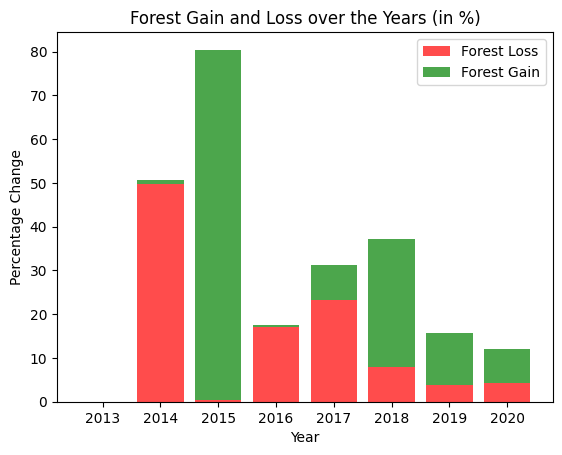

In [ ]:
import numpy as np
import os
import rasterio
import matplotlib.pyplot as plt

# Directory containing the predicted images
predicted_dir = "./predicted"
predicted_image_files = sorted([os.path.join(predicted_dir, f) for f in os.listdir(predicted_dir) if f.endswith('.tif')])

previous_forest_cover = None
forest_gain_percentages = []
forest_loss_percentages = []

# Process each predicted image
for f in predicted_image_files:
    with rasterio.open(f) as src:
        forest_cover = src.read(1) > 0.5

        if previous_forest_cover is not None:
            forest_loss = np.logical_and(previous_forest_cover, ~forest_cover)
            forest_gain = np.logical_and(~previous_forest_cover, forest_cover)

            loss_percentage = (np.sum(forest_loss) / np.sum(previous_forest_cover)) * 100
            gain_percentage = (np.sum(forest_gain) / np.sum(previous_forest_cover)) * 100

            forest_loss_percentages.append(loss_percentage)
            forest_gain_percentages.append(gain_percentage)
        else:
            forest_loss_percentages.append(0)
            forest_gain_percentages.append(0)

        previous_forest_cover = forest_cover

# Plotting
years = list(range(2013, 2021))
plt.bar(years, forest_loss_percentages, color='red', label='Forest Loss', alpha=0.7)
plt.bar(years, forest_gain_percentages, color='green', label='Forest Gain', alpha=0.7, bottom=forest_loss_percentages)
plt.xlabel('Year')
plt.ylabel('Percentage Change')
plt.title('Forest Gain and Loss over the Years (in %)')
plt.legend()
plt.show()
